## Задание: 

есть какое-то перемещение пользователя по маркетплейсу, которое заканчивается каким-то заказом. Каждое такое перемещение хранится в виде сессии, у которой есть начало и конец

Заказ может сопровождаться или не сопровождаться целевой ЗАГАДОЧНОЙ переменной (1 и 0 соотв.).

Вам даны предсказания пяти разных моделей, которые были обучены на какой-то обучающей выборке на исходных признаках, а также таймстемпы заказа (order_create_time) и конца сессии (session_end_time). Заказ не обязательно наступает в конце сессии.

Нужно по этим всем показателям предсказать целевую переменную.

In [268]:
from itertools import combinations
from functools import partial

import pandas as pd
import numpy as np
import lightgbm as lgb
import shap
import hdbscan
import umap
import optuna
from scipy.special import expit

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import KFold
from sklearn.cluster import KMeans
# from local_utils import *

#### Read

In [271]:
df_train = pd.read_parquet('train.parquet')
df_test = pd.read_parquet('test.parquet')

#### Generate features

In [273]:
all_cols = df_train.columns.to_list()
all_cols = [e for e in all_cols if e not in ['order_create_time', 'session_end_time']]
model_cols = [col for col in df_train.columns.to_list() if col.startswith('model')]

##### Time

In [281]:
min_time = df_train['order_create_time'].min()
def create_time_deltas(df, min_time):
    df['time_past'] = (df['order_create_time'] - df['order_create_time'].min()).dt.total_seconds()
    df['delta_time'] = (df['order_create_time'] - df['session_end_time']).dt.total_seconds()

create_time_deltas(df_train,min_time)
create_time_deltas(df_test,min_time)

##### Scaled

In [287]:
model_cols += ['delta_time']
def scale(df_train, df_test, model_cols):
    for col in model_cols:
        transf = MinMaxScaler().fit(df_train[col].to_frame())
        df_train[f'{col}_scaled'] = transf.transform(df_train[col].to_frame())
        df_test[f'{col}_scaled'] = transf.transform(df_test[col].to_frame())
        
scale(df_train, df_test, model_cols)

##### На графике model_3 похожа на сигмоиду

<Axes: xlabel='delta_time_scaled', ylabel='model_3'>

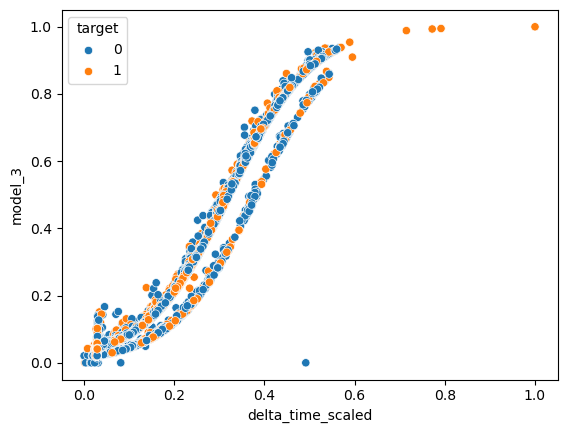

In [263]:
sns.scatterplot(df_train, x='delta_time_scaled', y='model_3', hue='target')

In [291]:
df_test['exp'] = expit(13*df_test['delta_time_scaled']-5)
df_train['exp'] = expit(13*df_train['delta_time_scaled']-5)

##### corr

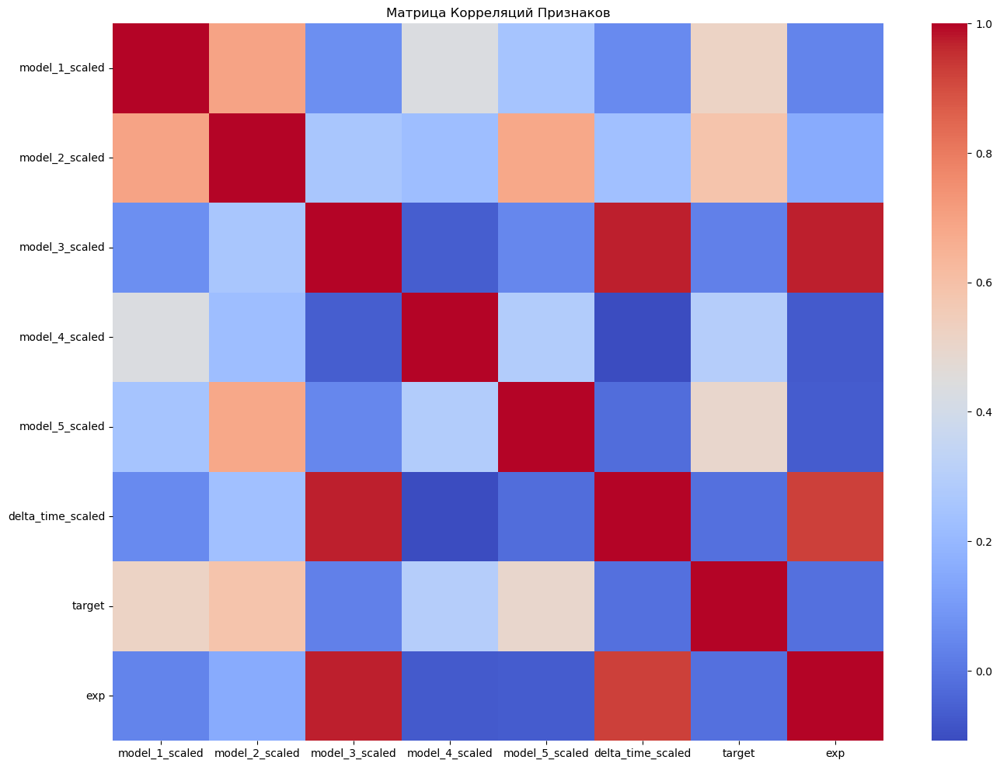

In [47]:
scaled_models = [col for col in df_train.columns.to_list() if 'scaled' in col]
correlation_matrix = df_train[scaled_models + ['target', 'exp']].corr()

plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=False) # annot=True покажет значения, но будет очень мелко
plt.title('Матрица Корреляций Признаков')
plt.show()

##### Берем скорелированные с target и находим статистики

In [299]:
scaled_models = ['model_1_scaled', 'model_2_scaled', 'model_5_scaled']

def get_stats(df, scaled_models):
    df['mean_models'] = np.mean(df[scaled_models], axis=1)
    df['median_models'] = np.median(df[scaled_models], axis=1)
    df['std_models'] = np.std(df[scaled_models], axis=1)

get_stats(df_train, scaled_models)
get_stats(df_test, scaled_models)

##### Берем попарные среди моделей

In [307]:
num_cols = [col for col in df_train.columns.to_list() if (('scaled' in col))] # scaled_cols

def generate_for_num_cols(df, num_cols):
    for col1, col2 in combinations(num_cols, 2):
        df[f"{col1}_*_{col2}"] = df[col1] * df[col2]
        df[f"{col1}_+_{col2}"] = df[col1] + df[col2]
        df[f"{col1}_-_{col2}"] = df[col1] - df[col2]
        df[f"{col1}_/_{col2}"] = df[col1] / df[col2]

    for col in num_cols:
        df[f"{col}_**2"] = df[col] **2

generate_for_num_cols(df_train, num_cols)
generate_for_num_cols(df_test, num_cols)

#### base model for best cols

In [325]:
cv_results = []
feature_importances = []

features = df_train.columns.to_list()
features = [col for col in features if col not in (['target', 'order_create_time', 'session_end_time', 'time_past', 'delta_time'] + ['model_1','model_2','model_3','model_4','model_5'])]

X = df_train[features]
y = df_train['target']
X_test = df_test[features]
predictions = np.zeros(X_test.shape[0])

n_splits = 10
cv_splits = [s for s in KFold(n_splits = n_splits, shuffle = True, random_state = 42).split(X)]

for idx_tr, idx_vl in cv_splits:
    X_tr, X_vl, y_tr, y_vl = X.iloc[idx_tr, :], X.iloc[idx_vl, :], y.iloc[idx_tr], y.iloc[idx_vl]

    scale_pos_weight = y_tr[y_tr==0].shape[0]/y_tr[y_tr==1].shape[0]
    model = lgb.LGBMClassifier(n_estimators=1000, random_state=42, importance_type='gain', scale_pos_weight=scale_pos_weight,)
    model.fit(X_tr, y_tr, eval_set=[(X_vl, y_vl)], eval_metric='auc', callbacks=[lgb.early_stopping(stopping_rounds=50)]) 
    
    predictions += model.predict_proba(X_test)[:,1]
    fold_result = {
        'auc': model.best_score_['valid_0']['auc'],
        'best_iteration': model.best_iteration_
    }
    cv_results.append(fold_result)

    importance = model.feature_importances_

    # Создаем DataFrame для наглядности
    feature_importance = pd.DataFrame({
        'Feature': X_tr.columns,
        'Importance': importance
    }).sort_values('Importance', ascending=False)

    feature_importances.append(feature_importance)

In [337]:
feature_importance = feature_importances[0].sort_values(by=["Feature"])

for D in feature_importances[1:]:
    D = D.sort_values(by=["Feature"])
    feature_importance["Importance"] += D["Importance"]

feature_importance["Importance"] /= n_splits
feature_importance = feature_importance.sort_values(by = ["Importance"], ascending=False)

from IPython.display import display
display(feature_importance.head(50))

,Feature,Importance
43,model_2_scaled_+_delta_time_scaled,363995.257455
5,delta_time_scaled,77909.115445
45,model_2_scaled_/_delta_time_scaled,37985.257657
44,model_2_scaled_-_delta_time_scaled,28530.444168
6,exp,17548.691038
42,model_2_scaled_*_delta_time_scaled,5044.082308
29,model_1_scaled_/_delta_time_scaled,4205.509764
27,model_1_scaled_+_delta_time_scaled,3048.301130
69,model_5_scaled_/_delta_time_scaled,1819.229078
59,model_4_scaled_+_model_5_scaled,1759.336590


#### Cluster

##### Shaps

In [370]:
good_cols = feature_importance.iloc[:50].Feature.values

idx_tr, idx_vl= cv_splits[0]
X = df_train[good_cols]
X_tr, X_vl, y_tr, y_vl = X.iloc[idx_tr, :], X.iloc[idx_vl, :], y.iloc[idx_tr], y.iloc[idx_vl]
scale_pos_weight = y[y==0].shape[0]/y[y==1].shape[0]

model = lgb.LGBMClassifier(n_estimators=1000, random_state=42, importance_type='gain', scale_pos_weight=scale_pos_weight,)
model.fit(X_tr, y_tr, eval_set=[(X_vl, y_vl)], eval_metric='auc', callbacks=[lgb.early_stopping(stopping_rounds=50)])

[LightGBM] [Info] Number of positive: 33381, number of negative: 60754
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005953 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12624
[LightGBM] [Info] Number of data points in the train set: 94135, number of used features: 50
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.354608 -> initscore=-0.598846
[LightGBM] [Info] Start training from score -0.598846
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[53]	valid_0's auc: 0.955496	valid_0's binary_logloss: 0.252959


LGBMClassifier(importance_type='gain', n_estimators=1000, random_state=42,
               scale_pos_weight=1.8193482304105233)

In [372]:
shap_values = model.predict(X_tr, pred_contrib=True)
shap_cols = list(good_cols) + ['zero_pred'] # в shap последняя колонка = const = phi_0
df_for_shap = pd.DataFrame(shap_values, columns=shap_cols) # делаем df из shaps (np.array)
df_for_shap.index = X_tr.index

df_scaled = df_for_shap.copy()

# Масштабируем шапы в 0,1
scaler = MinMaxScaler()
df_scaled[good_cols] = scaler.fit_transform(df_for_shap[good_cols])
df_scaled = df_scaled.drop('zero_pred', axis=1)

##### Umap

In [398]:
np.random.seed(42)
mapper = umap.UMAP(n_jobs=10, n_neighbors=100, metric='euclidean')
emb = mapper.fit_transform(df_scaled)

D:\ProgramFiles\Anaconda\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


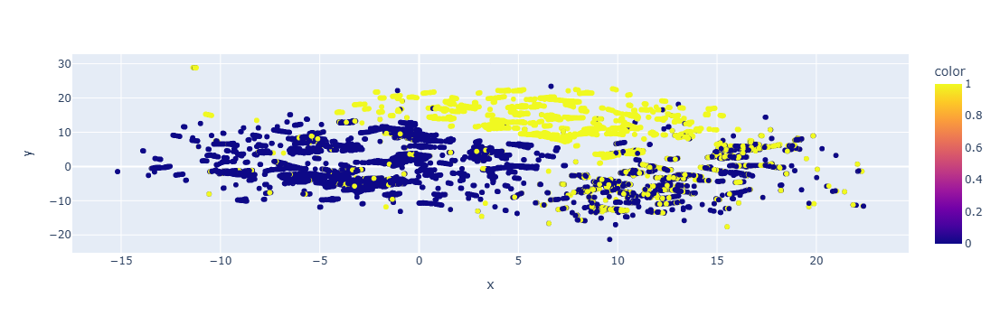

In [404]:
embs = pd.DataFrame({
    'x': emb[:, 0],
    'y': emb[:, 1],
    'color': y_tr

})
fig = px.scatter(data_frame=embs, x='x', y='y', color='color')
fig.update_layout(width=800)

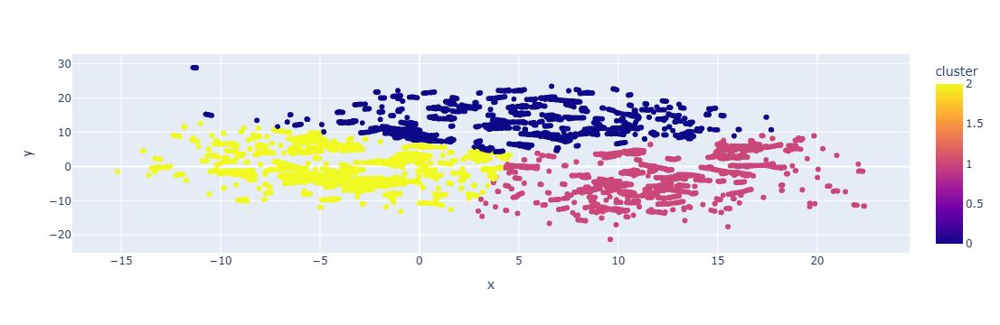

In [490]:
kmeans = KMeans(n_clusters=3, random_state=42).fit(emb)
clusters = kmeans.predict(emb)
embs['cluster'] = clusters

fig = px.scatter(data_frame=embs, x='x', y='y', color='cluster')
fig.update_layout(width=800)

##### правим кластера

In [492]:
embs.loc[(embs['cluster']==0) & (embs['x']<2)& (embs['x']>-3) & (embs['y']<12), 'cluster'] = 2
embs.loc[(embs['cluster']==0) & (embs['x']<5.5)& (embs['x']>2.5) & (embs['y']<9), 'cluster'] = 2
embs.loc[(embs['cluster']==0) & (embs['x']<-0.1)& (embs['x']>-1) & (embs['y']<14), 'cluster'] = 2

##### Модель для прогнозирования кластера

In [516]:
model_cluster = lgb.LGBMClassifier(objective='multiclass', num_class=embs.cluster.unique().shape[0], random_state=42,)
model_cluster.fit(X_tr[good_cols], embs['cluster'])

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005782 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12624
[LightGBM] [Info] Number of data points in the train set: 94135, number of used features: 50
[LightGBM] [Info] Start training from score -1.394518
[LightGBM] [Info] Start training from score -1.296140
[LightGBM] [Info] Start training from score -0.737179


LGBMClassifier(num_class=3, objective='multiclass', random_state=42)

In [518]:
df_train['cluster'] = model_cluster.predict(df_train[good_cols])
df_test['cluster'] = model_cluster.predict(df_test[good_cols])

col = 'cluster'
df_train[col] = df_train[col].astype('category')
df_test[col] = df_test[col].astype('category')

#### Final model

In [536]:
cv_results = []
feature_importances = []

features = list(good_cols) + ['cluster']

X = df_train[features]
y = df_train['target']
X_test = df_test[features]
predictions = np.zeros(X_test.shape[0])

n_splits = 10
cv_splits = [s for s in KFold(n_splits = n_splits, shuffle = True, random_state = 42).split(X)]

for idx_tr, idx_vl in cv_splits:
    X_tr, X_vl, y_tr, y_vl = X.iloc[idx_tr, :], X.iloc[idx_vl, :], y.iloc[idx_tr], y.iloc[idx_vl]

    scale_pos_weight = y_tr[y_tr==0].shape[0]/y_tr[y_tr==1].shape[0]
    model = lgb.LGBMClassifier(n_estimators=1000, random_state=42, importance_type='gain', scale_pos_weight=scale_pos_weight,) 
    model.fit(X_tr, y_tr, eval_set=[(X_vl, y_vl)], eval_metric='auc', callbacks=[lgb.early_stopping(stopping_rounds=50)])
    predictions += model.predict_proba(X_test)[:,1]

    fold_result = {
        'auc': model.best_score_['valid_0']['auc'],
        'best_iteration': model.best_iteration_
    }
    cv_results.append(fold_result)

    importance = model.feature_importances_

    # Создаем DataFrame для наглядности
    feature_importance = pd.DataFrame({
        'Feature': X_tr.columns,
        'Importance': importance
    }).sort_values('Importance', ascending=False)

    feature_importances.append(feature_importance)

In [546]:
df_test['is_callcenter'] = predictions/n_splits

name = 'cv_scaled_delta_time_stats_exp_gen_clusters'
df_test[['order_id', 'is_callcenter']].to_parquet(f'submission_{name}.parquet')

<Axes: xlabel='is_callcenter', ylabel='Count'>

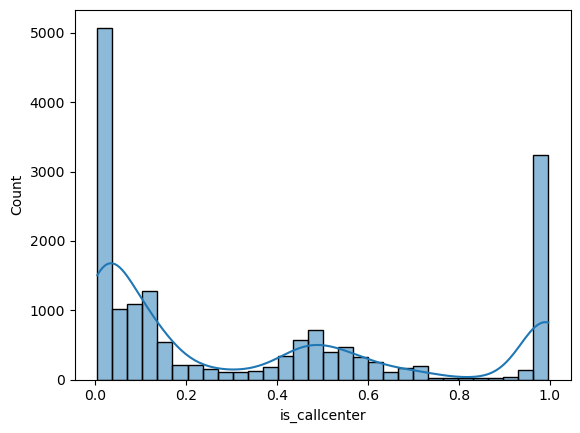

In [552]:
sns.histplot(data=df_test, x='is_callcenter', 
             kde=True, bins=30, alpha=0.5)